In [1]:
import numpy as np
import cartopy.io.shapereader as shpreader
import shapely
from cartopy.feature import ShapelyFeature
from matplotlib import pyplot as plt

In [2]:
import os
shpfiles = [o for o in os.listdir('data/uk/bdline_essh_gb/Data/GB') if o.split('.')[1] == 'shp']
shpfiles

['parish_region.shp',
 'greater_london_const_region.shp',
 'district_borough_unitary_ward_region.shp',
 'westminster_const_region.shp',
 'unitary_electoral_division_region.shp',
 'district_borough_unitary_region.shp',
 'high_water_polyline.shp',
 'county_region.shp',
 'scotland_and_wales_region.shp',
 'english_region_region.shp',
 'county_electoral_division_region.shp',
 'UK_regions.shp',
 'scotland_and_wales_const_region.shp']

In [12]:
shpfile = shpreader.Reader('data/uk/bdline_essh_gb/Data/GB/UK_regions.shp')
shpfile

DriverError: ../data/uk/bdline_essh_gb/Data/GB/UK_regions.shp: No such file or directory

In [15]:
list(shpfile.geometries())

In [42]:
# set([s for s in shpfile.records()])
(next(shpfile.records())).attributes
set(r.attributes['NAME'] for r in shpfile.records())
list(r.attributes['NAME'] for r in shpfile.records())

['North West English Region',
 'South West English Region',
 'East Midlands English Region',
 'London English Region',
 'West Midlands English Region',
 'Yorkshire and the Humber English Region',
 'South East English Region',
 'North East English Region',
 'Eastern English Region']

In [64]:
import OSGridConverter
from numbers import Number
g = OSGridConverter.grid.OSGridReference(10,10)
args = [3,3,3][:2]
areNumbers = lambda arr: all([isinstance(x,Number) and not isinstance(x,bool) for x in arr])
len(args)>=2 and areNumbers(args[:2])
# all([isinstance(x,Number) and not isinstance(x,bool) for x in [3,3,3]])
# OSGridConverter.grid2latlong([3,3,3])

True

In [29]:
demo_geom = next(shpfile.geometries())

new_points = [demo_geom.exterior.coords]

(357067.4969, 586765.5996)

In [4]:
def flatten(nested_list):
    new_list = []
    for element in nested_list:
        if isinstance(element, shapely.geometry.polygon.Polygon):
            new_list.append(element)
        else:
            try:
                new_list+=flatten(element)
            except TypeError:
                new_list.append(element)
    return new_list


flatten([1,2,[3,4]])

[1, 2, 3, 4]

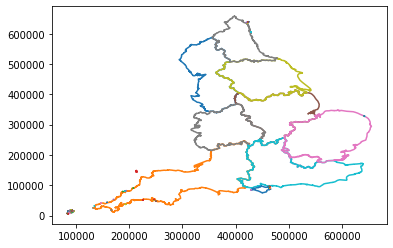

In [23]:
shapes = list(flatten(([p if isinstance(p, shapely.geometry.polygon.Polygon) else list(p.geoms) for p in shpfile.geometries()])))
shapes
[plt.plot(*list(zip(*list(g.exterior.coords)))) for g in shapes]
plt.show()

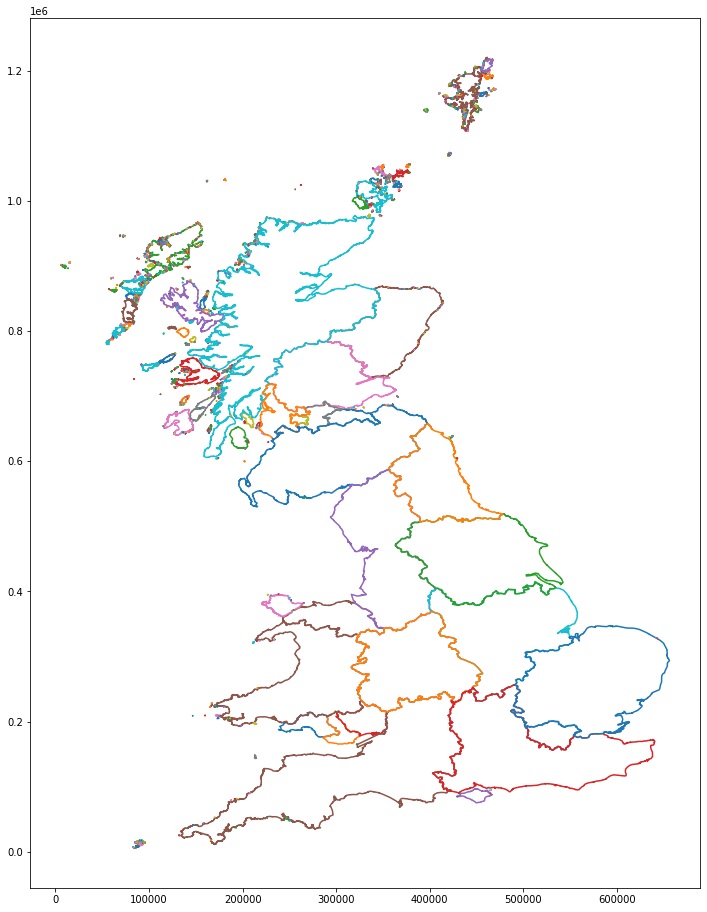

In [6]:
files = [
    # 'parish_region.shp',
#  'greater_london_const_region.shp',
#  'district_borough_unitary_ward_region.shp',
#  'westminster_const_region.shp',
#  'unitary_electoral_division_region.shp',
#  'district_borough_unitary_region.shp',
#  'high_water_polyline.shp',
#  'county_region.shp',
 'scotland_and_wales_region.shp',
 'english_region_region.shp',
#  'county_electoral_division_region.shp',
#  'scotland_and_wales_const_region.shp',
 ]
plt.figure(figsize=(12,16))
for shpfilename in files:
    shpfile = shpreader.Reader(f'../data/uk/bdline_essh_gb/Data/GB/{shpfilename}')
    shapes = list(flatten(([p if isinstance(p, shapely.geometry.polygon.Polygon) else list(p.geoms) for p in shpfile.geometries()])))
    [plt.plot(*list(zip(*list(g.exterior.coords)))) for g in shapes]
plt.show()


        

In [9]:
from matplotlib import pyplot as plt
import cartopy.crs as ccrs


In [3]:
shpfile = shpreader.Reader('data/uk/bdline_essh_gb/Data/GB/UK_regions.shp')
shpfile

In [5]:
next(shpfile.geometries()).area

2.047363625688714

In [7]:
len(list(shpfile.geometries()))
len([g for g in shpfile.geometries() if g.area > 2])

8

In [ ]:
plt.bar([g.area for g in shpfile.geometries()])

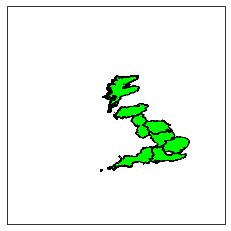

In [11]:
fig = plt.figure()
ax = fig.add_subplot((111),projection=ccrs.PlateCarree())
ax.set_extent([-15, 5,45, 65], ccrs.PlateCarree())
# ax.set_extent([-15, 5,45, 65], ccrs.PlateCarree())
# ax.set_global()

shape_feature = ShapelyFeature([next(shpfile.geometries())], ccrs.PlateCarree(), facecolor="lime", edgecolor='black', lw=1)
ax.add_feature(shape_feature)

for g in shpfile.geometries():
    if g.area < 2:
        continue
    shape_feature = ShapelyFeature([g], ccrs.PlateCarree(), facecolor="lime", edgecolor='black', lw=1)
    ax.add_feature(shape_feature)